In [ ]:
!pip install -q kaggle

In [ ]:
from google.colab import files
files.upload()

In [ ]:
! mkdir ~/.kaggle

In [ ]:
! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle datasets list

In [ ]:
!kaggle datasets download -d imakash3011/customer-personality-analysis

In [ ]:
!kaggle datasets download -d tunguz/big-five-personality-test

In [ ]:
!unzip /content/customer-personality-analysis.zip

In [ ]:
!unzip /content/big-five-personality-test.zip

*The Big Five personality traits, also known as the five-factor model (FFM) and the OCEAN model, is a taxonomy, or grouping, for personality traits. When factor analysis (a statistical technique) is applied to personality survey data, some words used to describe aspects of personality are often applied to the same person. For example, someone described as conscientious is more likely to be described as "always prepared" rather than "messy". This theory is based therefore on the association between words but not on neuropsychological experiments. This theory uses descriptors of common language and therefore suggests five broad dimensions commonly used to describe the human personality and psyche.*

The theory identifies five factors:

**OPENNESS TO EXPERIENCE** (inventive/curious vs. consistent/cautious)<br>
**CONSCIENTIOUSNESS** (efficient/organized vs. extravagant/careless)<br>
**EXTRAVERSION** (outgoing/energetic vs. solitary/reserved)<br>
**AGREEABLENESS** (friendly/compassionate vs. critical/rational)<br>
**NEUROTICISM** (sensitive/nervous vs. resilient/confident)<br>

***Code***

In [ ]:
import pandas as pd
import numpy as np

df = pd.read_csv('/content/IPIP-FFM-data-8Nov2018/data-final.csv', delimiter="\t")

In [ ]:
df.head(3)

,EXT1,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,EXT8,EXT9,EXT10,EST1,EST2,EST3,EST4,EST5,EST6,EST7,EST8,EST9,EST10,AGR1,AGR2,AGR3,AGR4,AGR5,AGR6,AGR7,AGR8,AGR9,AGR10,CSN1,CSN2,CSN3,CSN4,CSN5,CSN6,CSN7,CSN8,CSN9,CSN10,...,AGR1_E,AGR2_E,AGR3_E,AGR4_E,AGR5_E,AGR6_E,AGR7_E,AGR8_E,AGR9_E,AGR10_E,CSN1_E,CSN2_E,CSN3_E,CSN4_E,CSN5_E,CSN6_E,CSN7_E,CSN8_E,CSN9_E,CSN10_E,OPN1_E,OPN2_E,OPN3_E,OPN4_E,OPN5_E,OPN6_E,OPN7_E,OPN8_E,OPN9_E,OPN10_E,dateload,screenw,screenh,introelapse,testelapse,endelapse,IPC,country,lat_appx_lots_of_err,long_appx_lots_of_err
0,4.0,1.0,5.0,2.0,5.0,1.0,5.0,2.0,4.0,1.0,1.0,4.0,4.0,2.0,2.0,2.0,2.0,2.0,3.0,2.0,2.0,5.0,2.0,4.0,2.0,3.0,2.0,4.0,3.0,4.0,3.0,4.0,3.0,2.0,2.0,4.0,4.0,2.0,4.0,4.0,...,4750.0,5475.0,11641.0,3115.0,3207.0,3260.0,10235.0,5897.0,1758.0,3081.0,6602.0,5457.0,1569.0,2129.0,3762.0,4420.0,9382.0,5286.0,4983.0,6339.0,3146.0,4067.0,2959.0,3411.0,2170.0,4920.0,4436.0,3116.0,2992.0,4354.0,2016-03-03 02:01:01,768.0,1024.0,9.0,234.0,6,1,GB,51.5448,0.1991
1,3.0,5.0,3.0,4.0,3.0,3.0,2.0,5.0,1.0,5.0,2.0,3.0,4.0,1.0,3.0,1.0,2.0,1.0,3.0,1.0,1.0,4.0,1.0,5.0,1.0,5.0,3.0,4.0,5.0,3.0,3.0,2.0,5.0,3.0,3.0,1.0,3.0,3.0,5.0,3.0,...,2158.0,2090.0,2143.0,2807.0,3422.0,5324.0,4494.0,3627.0,1850.0,1747.0,5163.0,5240.0,7208.0,2783.0,4103.0,3431.0,3347.0,2399.0,3360.0,5595.0,2624.0,4985.0,1684.0,3026.0,4742.0,3336.0,2718.0,3374.0,3096.0,3019.0,2016-03-03 02:01:20,1360.0,768.0,12.0,179.0,11,1,MY,3.1698,101.706
2,2.0,3.0,4.0,4.0,3.0,2.0,1.0,3.0,2.0,5.0,4.0,4.0,4.0,2.0,2.0,2.0,2.0,2.0,1.0,3.0,1.0,4.0,1.0,4.0,2.0,4.0,1.0,4.0,4.0,3.0,4.0,2.0,2.0,2.0,3.0,3.0,4.0,2.0,4.0,2.0,...,1089.0,2203.0,3386.0,1464.0,2562.0,1493.0,3067.0,13719.0,3892.0,4100.0,4286.0,4775.0,2713.0,2813.0,4237.0,6308.0,2690.0,1516.0,2379.0,2983.0,1930.0,1470.0,1644.0,1683.0,2229.0,8114.0,2043.0,6295.0,1585.0,2529.0,2016-03-03 02:01:56,1366.0,768.0,3.0,186.0,7,1,GB,54.9119,-1.3833


In [ ]:
df.shape

(1015341, 110)

In [ ]:
df.columns

Index(['EXT1', 'EXT2', 'EXT3', 'EXT4', 'EXT5', 'EXT6', 'EXT7', 'EXT8', 'EXT9',
       'EXT10',
       ...
       'dateload', 'screenw', 'screenh', 'introelapse', 'testelapse',
       'endelapse', 'IPC', 'country', 'lat_appx_lots_of_err',
       'long_appx_lots_of_err'],
      dtype='object', length=110)

In [ ]:
#too much columns, let's cut it , we take the most important one in the codebook => description of the data
X=df[df.columns[0:50]]

In [ ]:
X.head(3)

,EXT1,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,EXT8,EXT9,EXT10,EST1,EST2,EST3,EST4,EST5,EST6,EST7,EST8,EST9,EST10,AGR1,AGR2,AGR3,AGR4,AGR5,AGR6,AGR7,AGR8,AGR9,AGR10,CSN1,CSN2,CSN3,CSN4,CSN5,CSN6,CSN7,CSN8,CSN9,CSN10,OPN1,OPN2,OPN3,OPN4,OPN5,OPN6,OPN7,OPN8,OPN9,OPN10
0,4.0,1.0,5.0,2.0,5.0,1.0,5.0,2.0,4.0,1.0,1.0,4.0,4.0,2.0,2.0,2.0,2.0,2.0,3.0,2.0,2.0,5.0,2.0,4.0,2.0,3.0,2.0,4.0,3.0,4.0,3.0,4.0,3.0,2.0,2.0,4.0,4.0,2.0,4.0,4.0,5.0,1.0,4.0,1.0,4.0,1.0,5.0,3.0,4.0,5.0
1,3.0,5.0,3.0,4.0,3.0,3.0,2.0,5.0,1.0,5.0,2.0,3.0,4.0,1.0,3.0,1.0,2.0,1.0,3.0,1.0,1.0,4.0,1.0,5.0,1.0,5.0,3.0,4.0,5.0,3.0,3.0,2.0,5.0,3.0,3.0,1.0,3.0,3.0,5.0,3.0,1.0,2.0,4.0,2.0,3.0,1.0,4.0,2.0,5.0,3.0
2,2.0,3.0,4.0,4.0,3.0,2.0,1.0,3.0,2.0,5.0,4.0,4.0,4.0,2.0,2.0,2.0,2.0,2.0,1.0,3.0,1.0,4.0,1.0,4.0,2.0,4.0,1.0,4.0,4.0,3.0,4.0,2.0,2.0,2.0,3.0,3.0,4.0,2.0,4.0,2.0,5.0,1.0,2.0,1.0,4.0,2.0,5.0,3.0,4.0,4.0


In [ ]:
pd.options.display.float_format = "{:.2f}".format
df.describe()

,EXT1,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,EXT8,EXT9,EXT10,EST1,EST2,EST3,EST4,EST5,EST6,EST7,EST8,EST9,EST10,AGR1,AGR2,AGR3,AGR4,AGR5,AGR6,AGR7,AGR8,AGR9,AGR10,CSN1,CSN2,CSN3,CSN4,CSN5,CSN6,CSN7,CSN8,CSN9,CSN10,...,EST7_E,EST8_E,EST9_E,EST10_E,AGR1_E,AGR2_E,AGR3_E,AGR4_E,AGR5_E,AGR6_E,AGR7_E,AGR8_E,AGR9_E,AGR10_E,CSN1_E,CSN2_E,CSN3_E,CSN4_E,CSN5_E,CSN6_E,CSN7_E,CSN8_E,CSN9_E,CSN10_E,OPN1_E,OPN2_E,OPN3_E,OPN4_E,OPN5_E,OPN6_E,OPN7_E,OPN8_E,OPN9_E,OPN10_E,screenw,screenh,introelapse,testelapse,endelapse,IPC
count,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,...,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013558.00,1013275.00,1013275.00,1013275.00,1013558.00,1015341.00,1015341.00
mean,2.65,2.77,3.29,3.14,3.28,2.40,2.77,3.41,2.96,3.56,3.29,3.17,3.85,2.66,2.84,2.84,3.05,2.68,3.09,2.77,2.26,3.83,2.26,3.93,2.27,3.74,2.20,3.69,3.79,3.59,3.30,2.93,3.98,2.62,2.63,2.83,3.70,2.47,3.20,3.59,...,7107.81,7942.96,5524.53,4755.13,18271.61,8798.99,6635.66,9045.58,11179.48,6255.79,8248.70,8956.07,5365.63,6046.34,12296.67,10254.03,9066.49,9198.06,9035.05,11725.84,5556.95,11138.42,5432.48,10788.70,8387.32,13014.47,7190.82,13289.73,6281.84,8256.58,7689.49,5423.94,6325.80,5336.31,1149.51,826.26,959.07,675.42,2701.41,10.45
std,1.26,1.32,1.22,1.24,1.28,1.23,1.40,1.27,1.35,1.31,1.35,1.23,1.16,1.25,1.27,1.33,1.29,1.34,1.30,1.32,1.34,1.14,1.28,1.13,1.17,1.22,1.12,1.10,1.17,1.08,1.18,1.39,1.04,1.25,1.27,1.42,1.13,1.14,1.28,1.05,...,431757.24,2154117.94,445318.62,170542.14,1741056.03,718069.68,259010.18,757183.83,2180418.44,350588.14,666975.94,1399846.88,163231.31,304489.74,1314490.89,572528.45,1257300.68,721609.44,1014837.49,2243966.30,268993.46,565574.04,404109.44,2205455.77,931681.73,1221541.65,376368.73,3047609.98,341401.39,564269.15,584198.71,262974.76,429890.56,440822.49,560.09,180.25,51040.05,20178.64,1483898.06,39.83
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,-2520786.00,-3599692.00,-79175662.00,-43558.00,-2757521.00,-3592606.00,-1795552.00,-67786.00,-61865.00,-247504.00,-65423.00,-764938.00,-527846.00,-85674.00,-3590638.00,-35996486.00,-94464.00,-3597020.00,-3512740.00,-74245.00,-100291.00,-2464695.00,-29167.00,-32337.00,-53927742.00,-215205.00,-417031.00,-74467.00,-128172.00,-7125690.00,-61813.00,-50012.00,-95986.00,-3594871.00,0.00,0.00,0.00,1.00,1.00,1.00
25%,1.00,2.00,2.00,2.00,2.00,1.00,2.00,2.00,2.00,3.00,2.00,2.00,3.00,2.00,2.00,2.00,2.00,2.00,2.00,2.00,1.00,3.00,1.00,3.00,1.00,3.00,1.00,3.00,3.00,3.00,3.00,2.00,3.00,2.00,2.00,2.00,3.00,2.00,2.00,3.00,...,2183.00,2071.00,1921.00,1760.00,2895.00,2246.00,2224.00,2190.00,2917.00,1998.00,2652.00,2659.00,2206.00,2379.00,2368.00,2955.00,2264.00,2330.00,2512.00,3096.00,2033.00,2452.00,2000.00,2648.00,2073.25,3054.00,1864.00,2680.00,1976.00,2364.00,2279.00,2144.00,2329.00,1484.00,414.00,720.00,5.00,171.00,9.00,1.00
50%,3.00,3.00,3.00,3.00,3.00,2.00,3.00,4.00,3.00,4.00,3.00,3.00,4.00,3.00,3.00,3.00,3.00,3.00,3.00,3.00,2.00,4.00,2.00,4.00,2.00,4.00,2.00,4.00,4.00,4.00,3.00,3.00,4.00,2.00,3.00,3.00,4.00,2.00,3.00,4.00,...,3146.00,2940.00,2773.00,2567.00,4362.00,3260.00,3160.00,3177.00,4067.00,2862.00,3699.00,3820.00,3122.00,3334.00,3516.00,4241.

In [ ]:
X.isnull().sum()

EXT1     1783
EXT2     1783
EXT3     1783
EXT4     1783
EXT5     1783
EXT6     1783
EXT7     1783
EXT8     1783
EXT9     1783
EXT10    1783
EST1     1783
EST2     1783
EST3     1783
EST4     1783
EST5     1783
EST6     1783
EST7     1783
EST8     1783
EST9     1783
EST10    1783
AGR1     1783
AGR2     1783
AGR3     1783
AGR4     1783
AGR5     1783
AGR6     1783
AGR7     1783
AGR8     1783
AGR9     1783
AGR10    1783
CSN1     1783
CSN2     1783
CSN3     1783
CSN4     1783
CSN5     1783
CSN6     1783
CSN7     1783
CSN8     1783
CSN9     1783
CSN10    1783
OPN1     1783
OPN2     1783
OPN3     1783
OPN4     1783
OPN5     1783
OPN6     1783
OPN7     1783
OPN8     1783
OPN9     1783
OPN10    1783
dtype: int64

In [ ]:
X = X.dropna()

In [ ]:
X.isna().sum()

EXT1     0
EXT2     0
EXT3     0
EXT4     0
EXT5     0
EXT6     0
EXT7     0
EXT8     0
EXT9     0
EXT10    0
EST1     0
EST2     0
EST3     0
EST4     0
EST5     0
EST6     0
EST7     0
EST8     0
EST9     0
EST10    0
AGR1     0
AGR2     0
AGR3     0
AGR4     0
AGR5     0
AGR6     0
AGR7     0
AGR8     0
AGR9     0
AGR10    0
CSN1     0
CSN2     0
CSN3     0
CSN4     0
CSN5     0
CSN6     0
CSN7     0
CSN8     0
CSN9     0
CSN10    0
OPN1     0
OPN2     0
OPN3     0
OPN4     0
OPN5     0
OPN6     0
OPN7     0
OPN8     0
OPN9     0
OPN10    0
dtype: int64

***EDA***

In [ ]:
#import pandas_profiling
#from pandas_profiling import ProfileReport\

In [ ]:
#profile = ProfileReport(df, title='Quick EDA personality Test - Pandas Profiling', html={'style':{'full_width':True}})

In [ ]:
#profile.to_file(output_file="EDA - ProfileReport.html")

**Model - KMEANS**

In [ ]:
#Vizualise
!pip install -U yellowbrick

     |████████████████████████████████| 271 kB 4.1 MB/s 
  Attempting uninstall: yellowbrick
    Found existing installation: yellowbrick 0.9.1
    Uninstalling yellowbrick-0.9.1:
      Successfully uninstalled yellowbrick-0.9.1


In [ ]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

K-Means using KElbowVisualizer to find the right value for K

In [ ]:
kmeans = KMeans()
visualizer = KElbowVisualizer(kmeans, k=(2,10))

In [ ]:
data_sample = X.sample(n=20000, random_state=42)

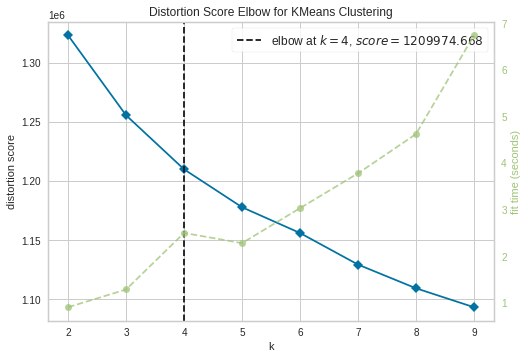

In [ ]:
visualizer.fit(data_sample)        # Fit the data to the visualizer
visualizer.show()                  # Finalize and render the figure

***K-MEANS*** <br>
*K-means clustering is a type of Unsupervised Learning, which is used when you have unlabeled data (i.e., data without defined categories or groups). The goal of this algorithm is to find groups in the data, with the number of groups represented by the variable K.*

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
kmeans = KMeans(n_clusters=4) #from the plot 

In [ ]:
k_fit = kmeans.fit(X)

In [ ]:
predict = k_fit.labels_

In [ ]:
X['clusters'] = predict
X.head()

,EXT1,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,EXT8,EXT9,EXT10,EST1,EST2,EST3,EST4,EST5,EST6,EST7,EST8,EST9,EST10,AGR1,AGR2,AGR3,AGR4,AGR5,AGR6,AGR7,AGR8,AGR9,AGR10,CSN1,CSN2,CSN3,CSN4,CSN5,CSN6,CSN7,CSN8,CSN9,CSN10,OPN1,OPN2,OPN3,OPN4,OPN5,OPN6,OPN7,OPN8,OPN9,OPN10,clusters
0,4.00,1.00,5.00,2.00,5.00,1.00,5.00,2.00,4.00,1.00,1.00,4.00,4.00,2.00,2.00,2.00,2.00,2.00,3.00,2.00,2.00,5.00,2.00,4.00,2.00,3.00,2.00,4.00,3.00,4.00,3.00,4.00,3.00,2.00,2.00,4.00,4.00,2.00,4.00,4.00,5.00,1.00,4.00,1.00,4.00,1.00,5.00,3.00,4.00,5.00,3
1,3.00,5.00,3.00,4.00,3.00,3.00,2.00,5.00,1.00,5.00,2.00,3.00,4.00,1.00,3.00,1.00,2.00,1.00,3.00,1.00,1.00,4.00,1.00,5.00,1.00,5.00,3.00,4.00,5.00,3.00,3.00,2.00,5.00,3.00,3.00,1.00,3.00,3.00,5.00,3.00,1.00,2.00,4.00,2.00,3.00,1.00,4.00,2.00,5.00,3.00,1
2,2.00,3.00,4.00,4.00,3.00,2.00,1.00,3.00,2.00,5.00,4.00,4.00,4.00,2.00,2.00,2.00,2.00,2.00,1.00,3.00,1.00,4.00,1.00,4.00,2.00,4.00,1.00,4.00,4.00,3.00,4.00,2.00,2.00,2.00,3.00,3.00,4.00,2.00,4.00,2.00,5.00,1.00,2.00,1.00,4.00,2.00,5.00,3.00,4.00,4.00,1
3,2.00,2.00,2.00,3.00,4.00,2.00,2.00,4.00,1.00,4.00,3.00,3.00,3.00,2.00,3.00,2.00,2.00,2.00,4.00,3.00,2.00,4.00,3.00,4.00,2.00,4.00,2.00,4.00,3.00,4.00,2.00,4.00,4.00,4.00,1.00,2.00,2.00,3.00,1.00,4.00,4.00,2.00,5.00,2.00,3.00,1.00,4.00,4.00,3.00,3.00,1
4,3.00,3.00,3.00,3.00,5.00,3.00,3.00,5.00,3.00,4.00,1.00,5.00,5.00,3.00,1.00,1.00,1.00,1.00,3.00,2.00,1.00,5.00,1.00,5.00,1.00,3.00,1.00,5.00,5.00,3.00,5.00,1.00,5.00,1.00,3.00,1.00,5.00,1.00,5.00,5.00,5.00,1.00,5.00,1.00,5.00,1.00,5.00,3.00,5.00,5.00,3


***Quick discover for the clusters***

In [ ]:
X["clusters"].value_counts()

2    277453
3    266347
0    247686
1    222072
Name: clusters, dtype: int64

In [ ]:
import plotly.express as px

In [ ]:
fig = px.bar(X, y = X["clusters"].value_counts().index, x = X["clusters"].value_counts(),orientation='h',
             labels={"x": "Total of individuals",
                     "y": "Clusters"})
fig.show()

In [ ]:
X.groupby('clusters').mean()

,EXT1,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,EXT8,EXT9,EXT10,EST1,EST2,EST3,EST4,EST5,EST6,EST7,EST8,EST9,EST10,AGR1,AGR2,AGR3,AGR4,AGR5,AGR6,AGR7,AGR8,AGR9,AGR10,CSN1,CSN2,CSN3,CSN4,CSN5,CSN6,CSN7,CSN8,CSN9,CSN10,OPN1,OPN2,OPN3,OPN4,OPN5,OPN6,OPN7,OPN8,OPN9,OPN10
clusters,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,3.45,1.93,3.79,2.50,4.03,1.84,3.64,2.76,3.77,2.99,3.73,2.98,4.17,2.45,3.24,3.39,3.74,3.38,3.60,3.11,2.20,4.24,2.68,4.12,2.05,3.94,1.89,3.86,4.07,3.83,2.94,3.61,3.82,3.22,2.23,3.52,3.43,2.83,2.91,3.46,3.73,2.11,4.23,1.97,3.96,1.78,3.97,3.37,4.16,4.19
1,2.08,3.43,2.80,3.55,2.55,2.87,2.03,3.70,2.49,3.95,2.51,3.58,3.21,2.90,2.37,2.07,2.32,1.92,2.58,2.29,2.80,3.09,2.34,3.11,2.94,2.96,2.85,3.07,2.92,3.10,3.29,2.69,3.79,2.31,2.54,2.60,3.54,2.41,2.99,3.44,3.50,2.03,3.62,2.09,3.60,2.07,3.90,3.04,3.80,3.65
2,1.84,3.57,2.39,4.01,2.42,3.08,1.81,4.10,2.15,4.45,4.22,2.50,4.52,2.18,3.47,3.74,3.83,3.55,3.86,3.75,2.27,3.52,2.33,4.02,2.36,3.99,2.51,3.61,3.87,3.24,3.12,3.03,3.98,3.10,2.42,3.09,3.77,2.75,3.12,3.50,3.54,2.32,4.06,2.11,3.51,2.04,3.76,3.15,4.32,3.75
3,3.22,2.18,4.16,2.49,4.08,1.82,3.59,3.07,3.45,2.83,2.55,3.68,3.37,3.17,2.21,2.04,2.21,1.77,2.24,1.85,1.83,4.39,1.73,4.32,1.82,3.96,1.61,4.13,4.17,4.16,3.82,2.40,4.27,1.82,3.28,2.12,4.00,1.88,3.73,3.93,3.83,1.82,4.04,1.84,4.09,1.70,4.27,3.17,4.15,4.22


***Get the right survey using lists***

In [ ]:
col_list = list(X)
ext = col_list[0:10]
est = col_list[10:20]
agr = col_list[20:30]
csn = col_list[30:40]
opn = col_list[40:50]

In [ ]:
survey = pd.DataFrame()
survey['EXTRAVERSION'] = X[ext].sum(axis=1)/10
survey['NEUROTICISM'] = X[est].sum(axis=1)/10
survey['AGREEABLENESS'] = X[agr].sum(axis=1)/10
survey['CONSCIENTIOUSNESS'] = X[csn].sum(axis=1)/10
survey['OPENNESS'] = X[opn].sum(axis=1)/10
survey['clusters'] = predict

In [ ]:
survey.head(3)

,EXTRAVERSION,NEUROTICISM,AGREEABLENESS,CONSCIENTIOUSNESS,OPENNESS,clusters
0,3.00,2.40,3.10,3.20,3.30,3
1,3.40,2.10,3.20,3.10,2.70,1
2,2.90,2.60,2.80,2.80,3.10,1


In [ ]:
fig = px.scatter_matrix(survey, dimensions= ['EXTRAVERSION', 'NEUROTICISM', 'AGREEABLENESS', 'CONSCIENTIOUSNESS', 'OPENNESS'], color="clusters")
fig.show()

In [ ]:
data_clusters = survey.groupby('clusters').mean()
data_clusters

,EXTRAVERSION,NEUROTICISM,AGREEABLENESS,CONSCIENTIOUSNESS,OPENNESS
clusters,,,,,
0,2.98,3.56,3.17,3.19,3.26
1,2.94,2.57,2.92,2.96,3.13
2,3.09,2.51,3.21,3.12,3.31
3,3.07,3.38,3.29,3.20,3.35


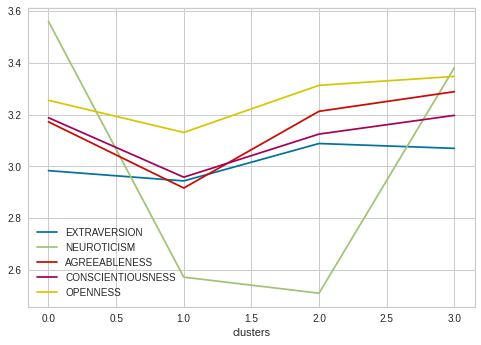

In [ ]:
data_clusters.plot()